# Imports

In [1]:
from IPython.display import Audio, display

from resemblyzer import preprocess_wav, VoiceEncoder
import matplotlib.pyplot as plt

from itertools import groupby
import itertools
flatten = itertools.chain.from_iterable
from math import ceil
from pathlib import Path
import datetime
import json
import collections

from tqdm import tqdm
from pydub.utils import make_chunks

import librosa
import librosa.display
import matplotlib
from matplotlib import style
import noisereduce as nr
import numpy as np
import sounddevice as sd
import webrtcvad

from pyannote.core import Segment, Timeline, Annotation, notebook
from pyannote.metrics.diarization import DiarizationErrorRate, GreedyDiarizationErrorRate, JaccardErrorRate

import scipy
from scipy.sparse import csgraph
# from scipy.sparse.linalg import eigsh
from numpy import linalg as LA
from scipy.spatial.distance import pdist, squareform, euclidean, cosine

import pandas as pd

## DO BEFORE: pip3 install --ignore-installed --upgrade ${wheel_url}
## find wheel URL here: https://github.com/lakshayg/tensorflow-build
# import deepspeech
from deepspeech import Model, version

from pydub import AudioSegment

AudioSegment.converter = '/usr/local/Cellar/ffmpeg/4.2.2_2/bin/ffmpeg'

# Constants and functions definitions

In [2]:
## Plots preparation

style.use('seaborn')

color = {
    -1: "black",
    0: "red",
    1: "orange",
    2: "blue",
    3: "brown",
    4: "purple",
    5: "plum",
    6: "gray",
    7: "khaki",
    8: "magenta",
    9: "cyan",
    10: "lime",
    11: "indigo",
    12: "royalblue",
    13: "dodgerblue",
    14: "lightcoral"
}

def timeTicks(x, pos):
    d = datetime.timedelta(seconds=x)
    return str(d)[-5:] if x < 3600 else str(d)
formatter = matplotlib.ticker.FuncFormatter(timeTicks)

In [3]:
from umap import UMAP

_default_colors = plt.rcParams["axes.prop_cycle"].by_key()["color"]
_my_colors = np.array([
    [0, 127, 70],
    [255, 0, 0],
    [255, 217, 38],
    [0, 135, 255],
    [165, 0, 165],
    [255, 167, 255],
    [97, 142, 151],
    [0, 255, 255],
    [255, 96, 38],
    [142, 76, 0],
    [33, 0, 127],
    [0, 0, 0],
    [183, 183, 183],
    [76, 255, 0],
], dtype=np.float) / 255

def plot_projections(embeds, speakers, ax=None, colors=None, markers=None, legend=True,
                     title="", **kwargs):
    if ax is None:
        _, ax = plt.subplots(figsize=(9, 6))

    # Compute the 2D projections. You could also project to another number of dimensions (e.g.
    # for a 3D plot) or use a different different dimensionality reduction like PCA or TSNE.
    reducer = UMAP(**kwargs)
    projs = reducer.fit_transform(embeds)

    # Draw the projections
    speakers = np.array(speakers)
    colors = colors or _my_colors
    for i, speaker in enumerate(np.unique(speakers)):
        speaker_projs = projs[speakers == speaker]
        marker = "o" if markers is None else markers[i]
        label = speaker if legend else None
        ax.scatter(*speaker_projs.T, c=[colors[i % 14]], marker=marker, label=label)

    if legend:
        ax.legend(title="Speakers", ncol=2)
    ax.set_title(title)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_aspect("equal")

    return projs

In [4]:
def get_speaker_segments(labels_list):
    N = np.array(labels_list)
    counter = np.arange(1, np.alen(N))
    groupings = np.split(N, counter[N[1:] != N[:-1]])

    segments = []
    start = 0
    for group in groupings:
        if group[0] is not None:
            segments.append({
                'start': start,
                'end': start + len(group) - 1,
                'speaker_id': group[0]
            })
        start += len(group)
    
    return segments

In [5]:
def plot_original_audio():
    # display(Audio(wav, rate=source_sr))

    fig = plt.figure(figsize=(13, 3))
    axes = plt.axes()
    plt.title('Original audio')
    librosa.display.waveplot(wav * 2, sr=source_sr, color='lightgray')

    for line in speaker_segments_full:
        plt.plot(
            [x[line['start']], x[line['end']]],
            ['Speaker ' + str(line['speaker_id']), 'Speaker ' + str(line['speaker_id'])],
            color=color[line['speaker_id'] % 15],
            linewidth=3
        )

    if SHOW_SPEAKER_SWITCHES:
        for xc in speaker_switches:
            plt.axvline(x=xc, linewidth=.5)

    axes.xaxis.set_major_formatter(formatter)
    ticks_freq = ceil(len(wav) * .1 / source_sr)
    axes.xaxis.set_major_locator(plt.MultipleLocator(ticks_freq))

    plt.margins(x=0.01)
    plt.tight_layout()

In [6]:
def plot_ground_truth():
    fig = plt.figure(figsize=(13, 3))
    axes = plt.axes()
    plt.title('Ground truth')
    librosa.display.waveplot(wav * 2, sr=source_sr, color='lightgray')

    for item in ami_corpus_transcripts:
        id = item['speaker_id']
        plt.plot(
            [item['start'], item['end']],
            ['Speaker ' + str(id), 'Speaker ' + str(id)],
            color=color[id % 15],
            linewidth=4
        )

    if SHOW_SPEAKER_SWITCHES:
        for xc in speaker_switches:
            plt.axvline(x=xc, linewidth=.5)

    axes.xaxis.set_major_formatter(formatter)
    ticks_freq = ceil(len(wav) * .1 / source_sr)
    axes.xaxis.set_major_locator(plt.MultipleLocator(ticks_freq))

    plt.margins(x=0.01)
    plt.tight_layout()

In [7]:
def get_hypothesis(speaker_segments):
    hypothesis = Annotation()
    for t in speaker_segments:
        try:
            hypothesis[Segment(x[t['start']], x[t['end']])] = str(t['speaker_id']) + '_hyp'
        except:
            pass
        
    return hypothesis

der = DiarizationErrorRate()
gder = GreedyDiarizationErrorRate()
jer = JaccardErrorRate()

def measure_metrics(reference, hypothesis):
    print('DER:', der(reference, hypothesis))
    # print(der.report())

    print('GDER:', gder(reference, hypothesis))
    # print(gder.report())

    print('JER:', jer(reference, hypothesis))
    # print(jer.report())

In [8]:
## https://towardsdatascience.com/spectral-graph-clustering-and-optimal-number-of-clusters-estimation-32704189afbe
## https://github.com/ciortanmadalina/high_noise_clustering/blob/master/spectral_clustering.ipynb
def getAffinityMatrix(coordinates, k = 7):
    """
    Calculate affinity matrix based on input coordinates matrix and the numeber
    of nearest neighbours.
    
    Apply local scaling based on the k nearest neighbour
        References:
    https://papers.nips.cc/paper/2619-self-tuning-spectral-clustering.pdf
    """
    # calculate euclidian distance matrix
    dists = squareform(pdist(coordinates)) 
    
    # for each row, sort the distances ascendingly and take the index of the 
    # k-th position (nearest neighbour)
    knn_distances = np.sort(dists, axis=0)[k]
    knn_distances = knn_distances[np.newaxis].T
    
    # calculate sigma_i * sigma_j
    local_scale = knn_distances.dot(knn_distances.T)

    affinity_matrix = dists * dists
    affinity_matrix = -affinity_matrix / local_scale
    # divide square distance matrix by local scale
    affinity_matrix[np.where(np.isnan(affinity_matrix))] = 0.0
    # apply exponential
    affinity_matrix = np.exp(affinity_matrix)
    np.fill_diagonal(affinity_matrix, 0)
    return affinity_matrix

def eigenDecomposition(A, plot = True, topK = 5):
    """
    :param A: Affinity matrix
    :param plot: plots the sorted eigen values for visual inspection
    :return A tuple containing:
    - the optimal number of clusters by eigengap heuristic
    - all eigen values
    - all eigen vectors
    
    This method performs the eigen decomposition on a given affinity matrix,
    following the steps recommended in the paper:
    1. Construct the normalized affinity matrix: L = D−1/2ADˆ −1/2.
    2. Find the eigenvalues and their associated eigen vectors
    3. Identify the maximum gap which corresponds to the number of clusters
    by eigengap heuristic
    
    References:
    https://papers.nips.cc/paper/2619-self-tuning-spectral-clustering.pdf
    http://www.kyb.mpg.de/fileadmin/user_upload/files/publications/attachments/Luxburg07_tutorial_4488%5b0%5d.pdf
    """
    L = csgraph.laplacian(A, normed=True)
    n_components = A.shape[0]
    
    # LM parameter : Eigenvalues with largest magnitude (eigs, eigsh), that is, largest eigenvalues in 
    # the euclidean norm of complex numbers.
    # eigenvalues, eigenvectors = eigsh(L, k=n_components, which="LM", sigma=1.0, maxiter=5000)
    eigenvalues, eigenvectors = LA.eig(L)
    
    if plot:
        plt.title('Largest eigen values of input matrix')
        plt.scatter(np.arange(len(eigenvalues)), eigenvalues)
        plt.grid()
        
    # Identify the optimal number of clusters as the index corresponding
    # to the larger gap between eigen values
    index_largest_gap = np.argsort(np.diff(eigenvalues))[::-1][:topK]
    nb_clusters = index_largest_gap + 1
        
    return nb_clusters, eigenvalues, eigenvectors

In [9]:
# SOURCE_FILE = "ES2002a.Mix-Headset.wav"
# SOURCE_FOLDER = "ami_corpus"
# TRANSCRIPTS = 'ami_corpus/transcripts.json'
# N_SPEAKERS = 4

SOURCE_FILE = "Pumpkin_and_Honey_Bunny.wav"
SOURCE_FOLDER = "records"
TRANSCRIPTS = 'records/transcripts.json'
N_SPEAKERS = 3

# SOURCE_FILE = "X2zqiX6yL3I.mp3"
# SOURCE_FOLDER = "audio_data"

FILEPATH = str(Path(SOURCE_FOLDER, SOURCE_FILE))

CUT_AUDIO = True
CUT_LENGTH = 7. * 60.

CHUNK_TIME_LENGTH = 2 # seconds
CHUNKS_OVERLAP = .1 # percents

# ## DeepSpeech
# # MODEL_FILE_PATH = 'deepspeech-0.6.1-models/output_graph.pb'
# # LM_FILE_PATH = 'deepspeech-0.6.1-models/lm.binary'
# # TRIE_FILE_PATH = 'deepspeech-0.6.1-models/trie'
# MODEL_FILE_PATH = 'deepspeech-0.7-models/deepspeech-0.7.0-models.pbmm'
# SCORER = 'deepspeech-0.7.0-models.scorer'

# BEAM_WIDTH = 500
# LM_ALPHA = 0.75
# LM_BETA = 1.85

# Data loading and preparation

In [10]:
## Load audio

wav, source_sr = librosa.load(FILEPATH, sr=None)

# print('original wav', wav[0:5], wav.shape)

if CUT_AUDIO and CUT_LENGTH < len(wav):
    wav = wav[0:ceil(CUT_LENGTH * source_sr)]
#     print('audio was cut', wav[0:5], wav.shape)

In [11]:
with open(TRANSCRIPTS, 'r') as f:
    ami_corpus_transcripts = json.load(f)
    
SHOW_SPEAKER_SWITCHES = True    

if SHOW_SPEAKER_SWITCHES:
    speaker_switches = [t['start'] for i, t in enumerate(ami_corpus_transcripts) \
        if i > 0 \
            and t['speaker_id'] != ami_corpus_transcripts[i - 1]['speaker_id'] \
            and t['end'] < CUT_LENGTH
    ]
    
    speaker_switches.insert(0, ami_corpus_transcripts[0]['start'])
    
if CUT_AUDIO and CUT_LENGTH < len(wav):
    ami_corpus_transcripts = [t for t in ami_corpus_transcripts if t['start'] < CUT_LENGTH]

reference = Annotation()
for t in ami_corpus_transcripts:
    try:
        reference[Segment(t['start'], t['end'])] = str(t['speaker_id']) + '_ref'
    except:
        pass

In [12]:
## Apply noise reducer

reduced_noise = nr.reduce_noise(audio_clip=wav, noise_clip=wav, verbose=False)

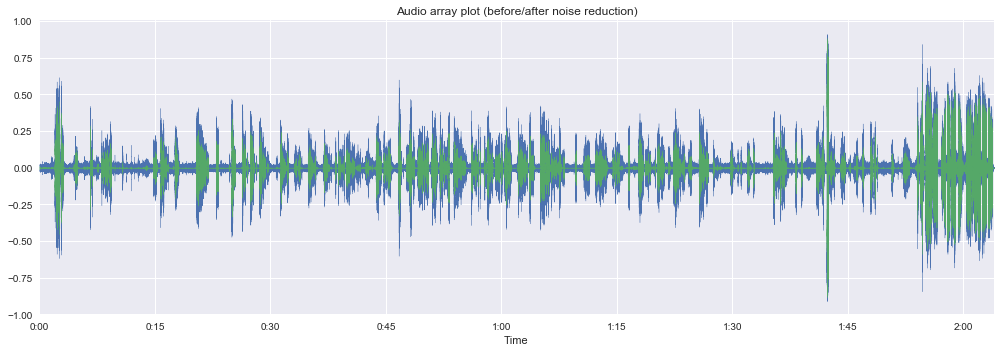

In [13]:
## Audio array plot
%matplotlib inline

fig = plt.figure(figsize=(14, 5))
plt.title('Audio array plot (before/after noise reduction)')
librosa.display.waveplot(wav, sr=source_sr)
librosa.display.waveplot(reduced_noise, sr=source_sr)

## Play audio
# sd.play(wavs, source_sr)
# sd.play(reduced_noise, source_sr)

# display(Audio(wav, rate=source_sr))
display(Audio(reduced_noise, rate=source_sr))

wav = reduced_noise
x = librosa.times_like(wav.shape[0], sr=source_sr, hop_length=1)

plt.margins(x=0.01)
plt.tight_layout()

# del reduced_noise

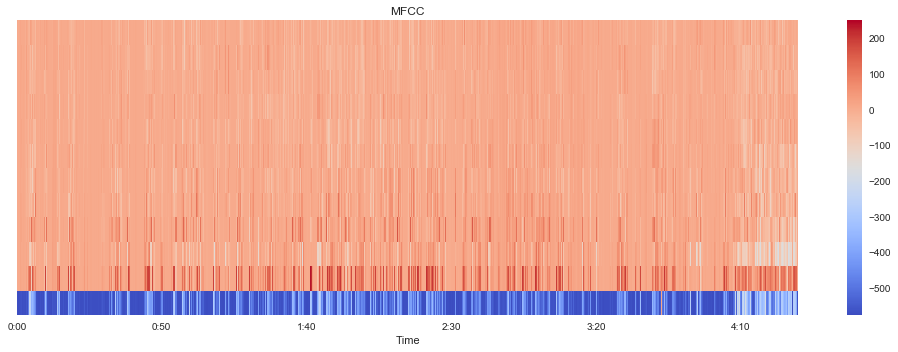

In [14]:
%matplotlib inline

fig = plt.figure(figsize=(14, 5))
mfccs = librosa.feature.mfcc(y=wav, sr=source_sr, n_mfcc=12)
plt.title('MFCC')
librosa.display.specshow(mfccs, x_axis='time')

plt.colorbar()
plt.margins(x=0.01)
plt.tight_layout()

In [15]:
## Split audio into chunks

chunk_size = ceil(CHUNK_TIME_LENGTH * source_sr)
chunks = [wav[i:i + chunk_size] for i in range(0, len(wav), chunk_size)]
speakers_list = [int(i / chunk_size) for i in range(0, len(wav))]
# print('chunks ', chunks[0:5], len(chunks))

# Applying Resemblyzer

In [16]:
## Process audio with Resemblyzer

preprocess = np.array(list(map(preprocess_wav, tqdm(
    chunks, "Preprocessing wavs", len(chunks)))))

masks = [w[1] for w in preprocess]
# print('masks', masks[0:5], len(masks))

wavs = np.array([w[0] for w in preprocess])
wavs_graph = np.concatenate(wavs).ravel()
# sd.play(wavs_graph, source_sr)
# print('wavs', len(wavs), wavs_graph[0:5], wavs_graph.shape)

final_length = sum([wav.shape[0] for wav in wavs])

# del chunks

Preprocessing wavs: 100%|██████████| 62/62 [00:00<00:00, 77.44it/s]


In [17]:
## Make masks for original audio

speakers = list(map(str, range(len(chunks))))
# print(speakers[0:5], len(speakers))
speaker_wavs = {
    speakers[i]: wavs[i] for i in range(len(wavs))
}
# print('speaker_wavs', speaker_wavs)

speakers_list = []
for index, wav_chunk in enumerate(wavs):
    for i in range(0, wav_chunk.shape[0]):
        speakers_list.append(index)
        
speakers_list_full = []
for index, mask_chunk in enumerate(masks):
    for i in range(0, len(mask_chunk)):
        speakers_list_full.append(index if mask_chunk[i] else -1)
            
mask = list(flatten(masks))

# print('speakers_list', speakers_list[0:5], len(speakers_list))
# print('speakers_list_full', speakers_list_full[0:5], len(speakers_list_full))

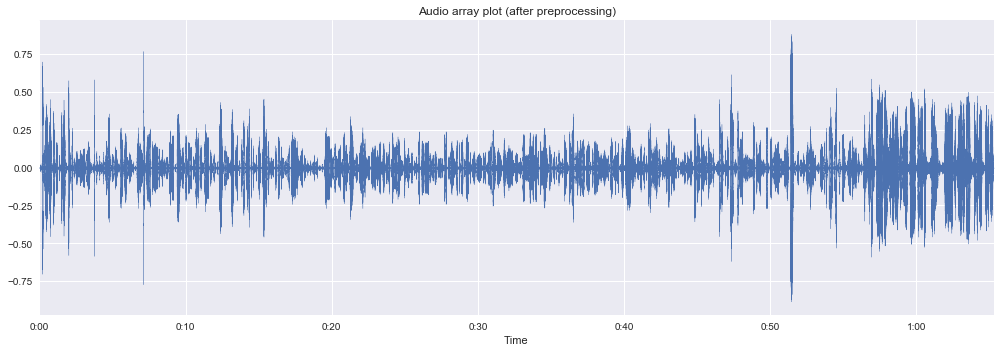

In [18]:
## Audio array plot (after preprocessing)
%matplotlib inline

display(Audio(wavs_graph, rate=source_sr))
# sd.play(wavs_graph, source_sr)

fig = plt.figure(figsize=(14, 5))
plt.title('Audio array plot (after preprocessing)')
librosa.display.waveplot(wavs_graph, sr=source_sr)
plt.margins(x=0.01)
plt.tight_layout()

In [19]:
## Compute the embeddings

encoder = VoiceEncoder()
utterance_embeds = np.array(list(map(encoder.embed_utterance, wavs)))
# print('utterance_embeds', utterance_embeds[0:5], len(utterance_embeds))

Loaded the voice encoder model on cpu in 0.01 seconds.


# Online diarization

In [20]:
def get_similarity(embed_i, embed_j):
#     return euclidean(embed_i, embed_j)
    return cosine(embed_i, embed_j)

In [21]:
clusters = [[wavs[0]]]
ids = [[0]]
ids_flat = [0]

speaker_change = .3

for i, embed in enumerate(utterance_embeds):
    if i > 0:
        similarity = get_similarity(embed, utterance_embeds[i - 1])
#         print(i, 'same speaker' if similarity > speaker_change else 'speaker change')
        
        if similarity < speaker_change:
            clusters[-1].append(wavs[i])
            ids[-1].append(i)
            ids_flat.append(ids_flat[-1])
        else:
            index = None
            for k in range(len(clusters)):
                if max([get_similarity(embed, utterance_embeds[ids[k][l]]) for l in range(len(ids[k]))]) < speaker_change:
                    clusters[k].append(wavs[i])
                    ids[k].append(i)
                    ids_flat.append(k)
                    index = k
                    break
            if not index:
                clusters.append([wavs[i]])
                ids_flat.append(len(ids))
                ids.append([i])
            

# for segment in clusters:
#     display(Audio(np.concatenate(segment).ravel(), rate=source_sr))

In [22]:
## Get speaker segments on audio timeline

speaker_segments = get_speaker_segments([ids_flat[i] for i in speakers_list])
speaker_segments_full = get_speaker_segments([ids_flat[i] if i > -1 else None for i in speakers_list_full])

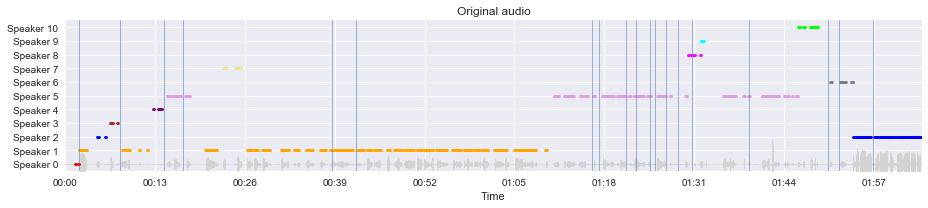

In [23]:
# %matplotlib notebook
%matplotlib inline

plot_original_audio()

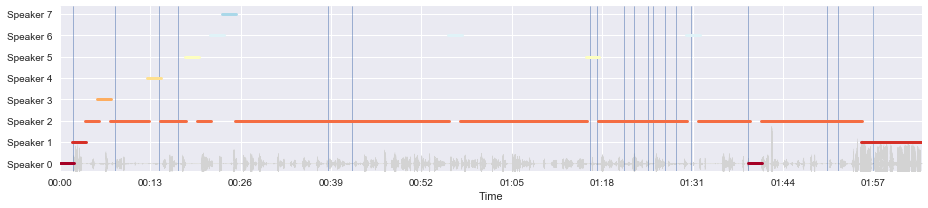

In [24]:
# %matplotlib notebook
%matplotlib inline

embeds = []
speakers_ids = [0]
speaker_change = .3

# fig = plt.figure(figsize=(9, 3))
# ax = fig.add_subplot()
fig = plt.figure(figsize=(13, 3))
axes = plt.axes()

# plt.title('Original audio')
librosa.display.waveplot(wav * 2, sr=source_sr, color='lightgray')
x = librosa.times_like(wav.shape[0], sr=source_sr, hop_length=1)

if SHOW_SPEAKER_SWITCHES:
    for xc in speaker_switches:
        plt.axvline(x=xc, linewidth=.5)

axes.xaxis.set_major_formatter(formatter)
ticks_freq = ceil(len(wav) * .1 / source_sr)
axes.xaxis.set_major_locator(plt.MultipleLocator(ticks_freq))

counter = 0

## Process overlapping chunks
for i in range(0, len(wav), ceil(chunk_size * (1 - CHUNKS_OVERLAP))):    
    start = i
    end = i + chunk_size if i + chunk_size < len(wav) - 1 else len(wav) - 1
    
    chunk = wav[start:end]
    
    preprocess = preprocess_wav(chunk)
    frame = preprocess[0]
    mask = preprocess[1]
    
    embed = encoder.embed_utterance(frame)
    best = 0

    if i > 0:
        similarities = [get_similarity(embed, previous) for previous in embeds]
#         print(similarities)
        best = np.argmin(similarities)
#         print(best)

        if similarities[best] > speaker_change:
            counter += 1
            speakers_ids.append(counter)
            best = len(speakers_ids) - 1
        else:
            speakers_ids.append(speakers_ids[best])

    plt.plot(
        [x[start], x[end]],
        [f'Speaker {str(speakers_ids[best])}', f'Speaker {str(speakers_ids[best])}'],
        linewidth=3, 
        color=plt.cm.RdYlBu(speakers_ids[best] * .1)
    )
    
#     ax.plot(
#         [x[start], x[end]],
#         [f'Speaker {str(speakers_ids[best])}', f'Speaker {str(speakers_ids[best])}'],
#         linewidth=3, 
#         color=plt.cm.RdYlBu(speakers_ids[best] * .1)
#     )
#     fig.canvas.draw()
#     fig.show()
#     plt.pause(CHUNK_TIME_LENGTH)

    embeds.append(embed)

plt.margins(x=0.01)
plt.tight_layout()

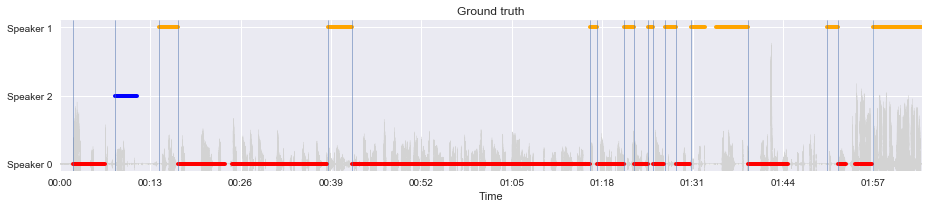

In [25]:
# %matplotlib notebook
%matplotlib inline

plot_ground_truth()

In [26]:
hypothesis = get_hypothesis(speaker_segments_full)

measure_metrics(reference, hypothesis)

DER: 0.7305949673486335
GDER: 0.7305949673486335
JER: 0.8157375477609486


/usr/local/lib/python3.7/site-packages/pyannote/metrics/utils.py:184: UserWarning: 'uem' was approximated by the union of 'reference' and 'hypothesis' extents.
  "'uem' was approximated by the union of 'reference' "


## UIS-RNN

In [27]:
# import uisrnn

# SAVED_MODEL_NAME = 'uis-rnn/saved_model.uisrnn'
# NUM_WORKERS = 4


# model_args = {
#     "observation_dim": 256,
#     "enable_cuda": False,
#     "rnn_hidden_size": 512,
#     "rnn_depth": 1,
#     "fc_depth": 1,
#     "rnn_dropout": .2,
#     "non_lin": True,
#     "transition_bias": None,
#     "crp_alpha": None,
#     "sigma2": None,
#     "verbosity": 2
# }
# model = uisrnn.UISRNN(model_args)
# model.load(SAVED_MODEL_NAME)

# test_sequences = utterance_embeds

# # testing
# predicted_cluster_ids = []
# test_record = []
# # predict sequences in parallel
# model.rnn_model.share_memory()
# pool = mp.Pool(NUM_WORKERS, maxtasksperchild=None)
# pred_gen = pool.imap(
#     func=partial(model.predict, args=inference_args),
#     iterable=test_sequences)
# # collect and score predicitons
# for idx, predicted_cluster_id in enumerate(pred_gen):
#   accuracy = uisrnn.compute_sequence_match_accuracy(
#       test_cluster_ids[idx], predicted_cluster_id)
#   predicted_cluster_ids.append(predicted_cluster_id)
#   test_record.append((accuracy, len(test_cluster_ids[idx])))
#   print('Ground truth labels:')
#   print(test_cluster_ids[idx])
#   print('Predicted labels:')
#   print(predicted_cluster_id)
#   print('-' * 80)

# # close multiprocessing pool
# pool.close()
# # close tensorboard writer
# writer.close()

# print('Finished diarization experiment')
# print(uisrnn.output_result(model_args, training_args, test_record))

# Supervised offline diarization

## Auto n_speakers estimation

Optimal number of clusters [ 1 16  2  4 25]


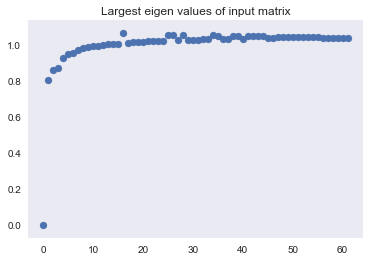

In [28]:
## Apply Spectral clustering

affinity_matrix = getAffinityMatrix(utterance_embeds, k=N_SPEAKERS)
k, _,  _ = eigenDecomposition(affinity_matrix)
print(f'Optimal number of clusters {k}')

n_speakers = max([n for n in k if n < 10][-1], 2)
# print(N_SPEAKERS, n_speakers)

## Spectral clustering with predefined n_clusters

In [29]:
from sklearn.cluster import SpectralClustering

clustering = SpectralClustering(
    affinity='cosine',
    n_clusters=N_SPEAKERS,
    assign_labels='discretize',
    random_state=0
)

clustering.fit(utterance_embeds)
labels = clustering.labels_

# print('clustering', labels[0:5], len(labels))

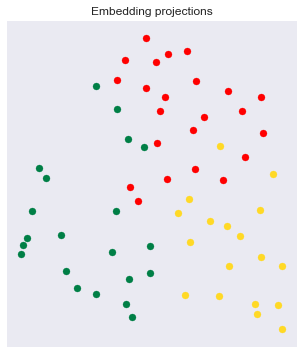

In [30]:
## Project the embeddings in 2D space

%matplotlib inline

projs = plot_projections(utterance_embeds, labels, title="Embedding projections", legend=False)
# print(projs)

In [31]:
## Get speaker segments on audio timeline

speaker_segments = get_speaker_segments([labels[i] for i in speakers_list])
speaker_segments_full = get_speaker_segments([labels[i] if i > -1 else None for i in speakers_list_full])

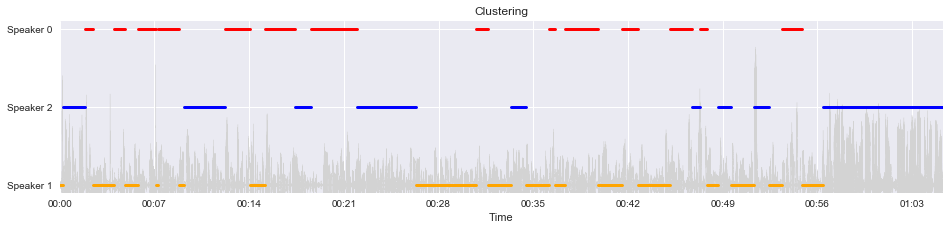

In [32]:
# %matplotlib notebook
%matplotlib inline

fig = plt.figure(figsize=(13, 3))
axes_cluster = plt.axes()
plt.title('Clustering')
librosa.display.waveplot(wavs_graph * 2, sr=source_sr, color='lightgray')
x_preprocessed = librosa.times_like(len(wavs_graph), sr=source_sr, hop_length=1)

for line in speaker_segments:
    plt.plot(
        [x_preprocessed[line['start']], x_preprocessed[line['end']]],
        ['Speaker ' + str(line['speaker_id']), 'Speaker ' + str(line['speaker_id'])],
        color=color[line['speaker_id'] % 15],
        linewidth=3
    )

axes_cluster.xaxis.set_major_formatter(formatter)
ticks_freq = ceil(len(wavs_graph) * .1 / source_sr)
axes_cluster.xaxis.set_major_locator(plt.MultipleLocator(ticks_freq))

plt.margins(x=0)
plt.tight_layout(pad=0.01)

# display(Audio(wav, rate=source_sr))
# display(Audio(wavs_graph, rate=source_sr))

# del wav
# del wavs_graph

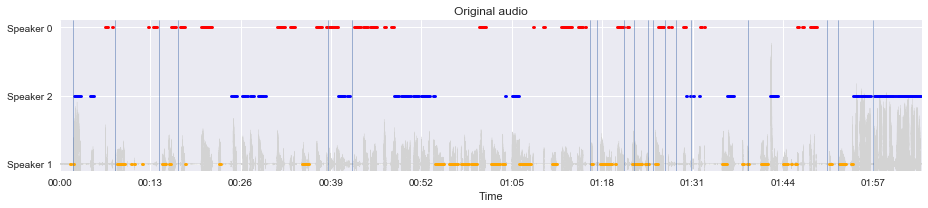

In [33]:
# %matplotlib notebook
%matplotlib inline

plot_original_audio()

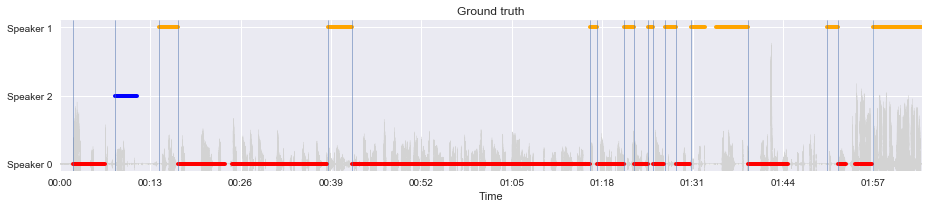

In [34]:
# %matplotlib notebook
%matplotlib inline
plot_ground_truth()

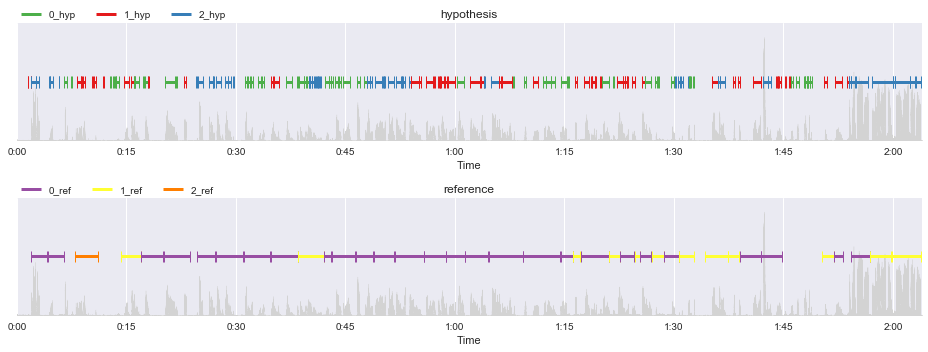

DER: 0.8067775570612518
GDER: 0.8067775570612518
JER: 0.8597222616898978


/usr/local/lib/python3.7/site-packages/pyannote/metrics/utils.py:184: UserWarning: 'uem' was approximated by the union of 'reference' and 'hypothesis' extents.
  "'uem' was approximated by the union of 'reference' "


In [35]:
## PyAnnote DER and other metrics

%matplotlib inline

fig = plt.figure(figsize=(13, 5))

# plot hypothesis
ax = plt.subplot(211)
plt.title('hypothesis')
ax.xaxis.set_major_formatter(formatter)
ticks_freq = ceil(len(wav) * .1 / source_sr)

hypothesis = get_hypothesis(speaker_segments_full)
notebook.plot_annotation(hypothesis, legend=True, time=True)
librosa.display.waveplot(wav, sr=source_sr, color='lightgray')

# plot reference
ax = plt.subplot(212)
plt.title('reference')
ax.xaxis.set_major_formatter(formatter)

notebook.plot_annotation(reference, legend=True, time=True)
librosa.display.waveplot(wav, sr=source_sr, color='lightgray')

plt.margins(x=0.01)
plt.tight_layout()
plt.show()

measure_metrics(reference, hypothesis)

## Spectral clustering with eigen decomposition for n_clusters

In [36]:
clustering = SpectralClustering(
    affinity='cosine',
    n_clusters=n_speakers,
    assign_labels='discretize',
    random_state=0
)

clustering.fit(utterance_embeds)
labels = clustering.labels_

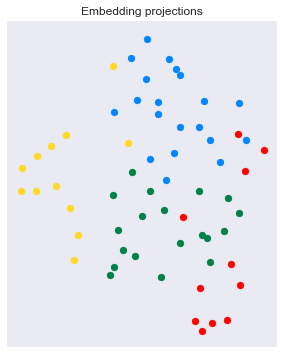

In [37]:
## Project the embeddings in 2D space

%matplotlib inline

projs = plot_projections(utterance_embeds, labels, title="Embedding projections", legend=False)
# print(projs)

In [38]:
## Get speaker segments on audio timeline

speaker_segments = get_speaker_segments([labels[i] for i in speakers_list])
speaker_segments_full = get_speaker_segments([labels[i] if i > -1 else None for i in speakers_list_full])

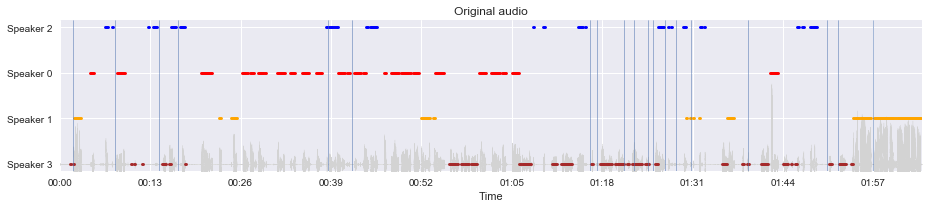

In [39]:
# %matplotlib notebook
%matplotlib inline

plot_original_audio()

In [40]:
hypothesis = get_hypothesis(speaker_segments_full)

measure_metrics(reference, hypothesis)

DER: 0.7847237294906639
GDER: 0.7847237294906639
JER: 0.8328449245767912


/usr/local/lib/python3.7/site-packages/pyannote/metrics/utils.py:184: UserWarning: 'uem' was approximated by the union of 'reference' and 'hypothesis' extents.
  "'uem' was approximated by the union of 'reference' "


## Spectral clustering but with fitting affinity matrix

In [41]:
clustering = SpectralClustering(
    affinity='precomputed',
    n_init=max(k),
    assign_labels='discretize',
    random_state=0
)

clustering.fit(squareform(pdist(utterance_embeds, 'cosine')))
labels = clustering.labels_

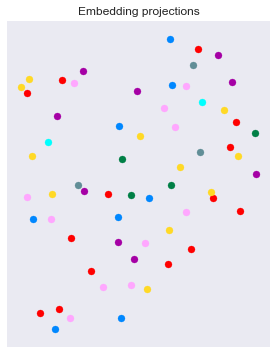

In [42]:
## Project the embeddings in 2D space

%matplotlib inline

projs = plot_projections(utterance_embeds, labels, title="Embedding projections", legend=False)
# print(projs)

In [43]:
## Get speaker segments on audio timeline

speaker_segments = get_speaker_segments([labels[i] for i in speakers_list])
speaker_segments_full = get_speaker_segments([labels[i] if i > -1 else None for i in speakers_list_full])

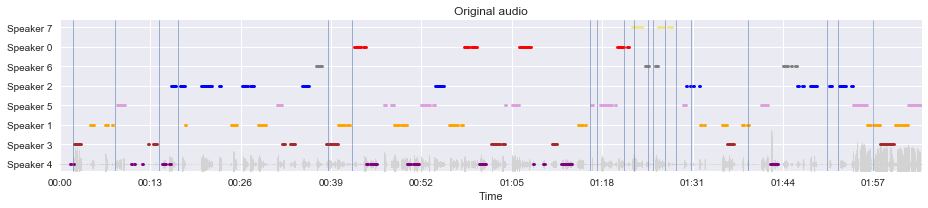

In [44]:
# %matplotlib notebook
%matplotlib inline

plot_original_audio()

In [45]:
hypothesis = get_hypothesis(speaker_segments_full)

measure_metrics(reference, hypothesis)

DER: 0.9060872150083045
GDER: 0.9060872150083045
JER: 0.8983061909080551


/usr/local/lib/python3.7/site-packages/pyannote/metrics/utils.py:184: UserWarning: 'uem' was approximated by the union of 'reference' and 'hypothesis' extents.
  "'uem' was approximated by the union of 'reference' "


## Agglomerative clustering

In [46]:
## Another clustering (Agglomerative Clustering)

from sklearn.cluster import AgglomerativeClustering

clustering = AgglomerativeClustering(
    n_clusters=None,
    compute_full_tree=True,
    affinity='cosine',
#     linkage='complete',
#     linkage='average',
    linkage='single',
    distance_threshold=.2
)
clustering.fit(utterance_embeds)
labels = clustering.labels_

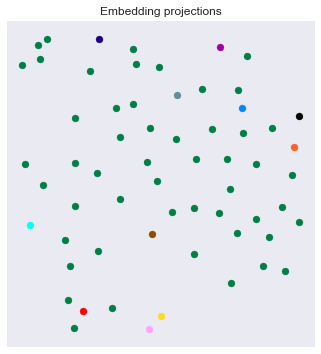

In [47]:
## Project the embeddings in 2D space

%matplotlib inline

projs = plot_projections(utterance_embeds, labels, title="Embedding projections", legend=False)
# print(projs)

In [48]:
## Get speaker segments on audio timeline

speaker_segments = get_speaker_segments([labels[i] for i in speakers_list])
speaker_segments_full = get_speaker_segments([labels[i] if i > -1 else None for i in speakers_list_full])

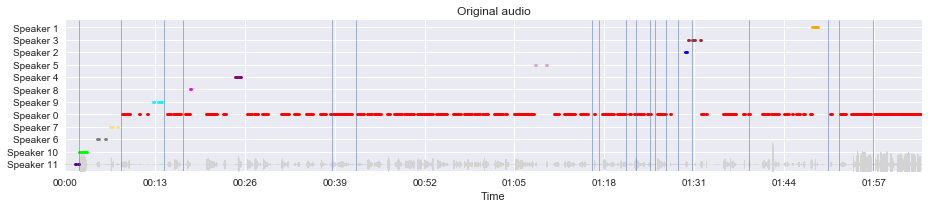

In [49]:
# %matplotlib notebook
%matplotlib inline

plot_original_audio()

In [50]:
hypothesis = get_hypothesis(speaker_segments_full)

measure_metrics(reference, hypothesis)

DER: 0.6567092581408229
GDER: 0.6567092581408229
JER: 0.8524414803308195


/usr/local/lib/python3.7/site-packages/pyannote/metrics/utils.py:184: UserWarning: 'uem' was approximated by the union of 'reference' and 'hypothesis' extents.
  "'uem' was approximated by the union of 'reference' "


## Spectral clustering proposed by Google

In [51]:
## Another clustering (google)

from spectralcluster import SpectralClusterer

# some_data = # numpy array of shape (n_samples, n_features)

clusterer = SpectralClusterer(
    min_clusters=max(min(k), 2),
    max_clusters=max(k),
    p_percentile=.2,
    gaussian_blur_sigma=.3)

labels = clusterer.predict(utterance_embeds) # is a numpy array of shape (n_samples,)

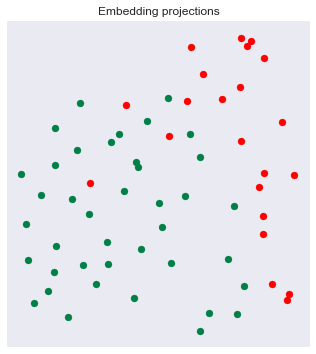

In [52]:
## Project the embeddings in 2D space

%matplotlib inline

projs = plot_projections(utterance_embeds, labels, title="Embedding projections", legend=False)
# print(projs)

In [53]:
## Get speaker segments on audio timeline

speaker_segments = get_speaker_segments([labels[i] for i in speakers_list])
speaker_segments_full = get_speaker_segments([labels[i] if i > -1 else None for i in speakers_list_full])

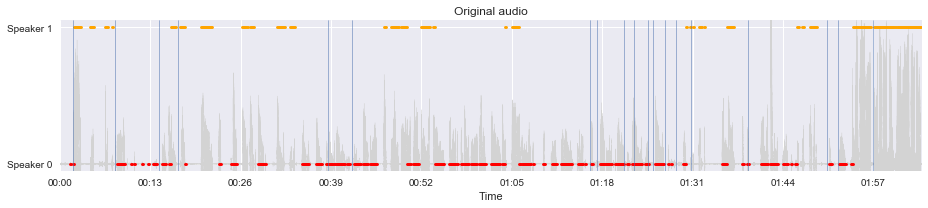

In [54]:
# %matplotlib notebook
%matplotlib inline

plot_original_audio()

In [55]:
hypothesis = get_hypothesis(speaker_segments_full)

measure_metrics(reference, hypothesis)

DER: 0.6794228760883794
GDER: 0.6794228760883794
JER: 0.8159431738952412


/usr/local/lib/python3.7/site-packages/pyannote/metrics/utils.py:184: UserWarning: 'uem' was approximated by the union of 'reference' and 'hypothesis' extents.
  "'uem' was approximated by the union of 'reference' "


## Hierarchical clustering

In [56]:
## Another clustering (hierarchy.fclusterdata)

from scipy.cluster.hierarchy import fclusterdata
from scipy.spatial.distance import cosine

labels = fclusterdata(utterance_embeds, 0.2, criterion='distance', metric=cosine)

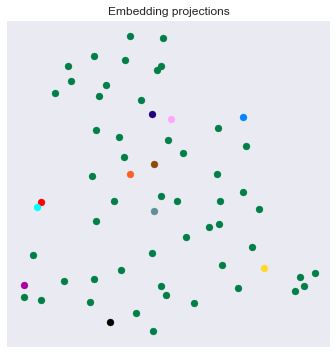

In [57]:
## Project the embeddings in 2D space

%matplotlib inline

projs = plot_projections(utterance_embeds, labels, title="Embedding projections", legend=False)
# print(projs)

In [58]:
## Get speaker segments on audio timeline

speaker_segments = get_speaker_segments([labels[i] for i in speakers_list])
speaker_segments_full = get_speaker_segments([labels[i] if i > -1 else None for i in speakers_list_full])

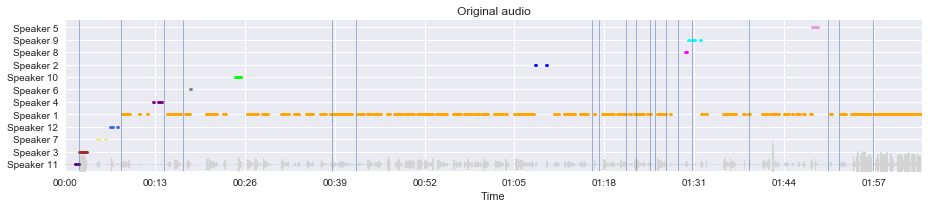

In [59]:
# %matplotlib notebook
%matplotlib inline

plot_original_audio()

In [60]:
hypothesis = get_hypothesis(speaker_segments_full)

measure_metrics(reference, hypothesis)

DER: 0.6567092581408229
GDER: 0.6567092581408229
JER: 0.8524414803308195


/usr/local/lib/python3.7/site-packages/pyannote/metrics/utils.py:184: UserWarning: 'uem' was approximated by the union of 'reference' and 'hypothesis' extents.
  "'uem' was approximated by the union of 'reference' "
